#  Introduction/Business Problem

## Description & Disscusion of the Background

"The main purpose of the American school is to provide for the fullest possible development of each learner for living morally, creatively, and productively in a democratic society." —The ASCD Committee on Platform of Beliefs, Educational Leadership, January 1957  This statement is powerful and convincing. However, can education be given fairly regardless of race, gender, place of origin, or background?

Education indeed is one of the most decisive elements and parameters for the children's economic future and success. I other words, it has a competitive and capitalistic aspect. I was born and raised in Japan, where elementary and middle school education is compulsory. Before kids attend an elementary school, they have an option of an affordable kindergarten and preschool for small toddlers. Even though the idea of sending small kids to these schools was not as popular as now, it is becoming more common as a society to accept and encourage more women to work in the workplace. 

Due to the fact that the population is declining, the cost of education for parents per child is also on the rise. The government's budget allocated to each city/ school is also fairly allocated, so that all children, regardless of family income, can study in the same classroom. From these reasons, I was able to grow up without having to feel the difference between wealthier children and me or be particularly aware of the characteristics of the area in which I lived.

I studied abroad in Los Angeles, California, fifteen years ago. I still remember the experience I had at that time. Los Angeles, with a population of 12 million, is one of the largest cities in the United States. It is a melting pot of ethnic groups, with people from all over the world. It was a fascinating city to live in. 

In reality, however, the gap between the rich and the poor is stark, and cities are racially segregated, creating divisiveness among people not only psychologically but also socially, culturally, and politically. This fact came as a shock to me when I first came to America. People with lower incomes cannot attend schools with a good program and high scores because of their school district, which results in limiting the possibilities of those kids who live in these particular areas. However, I only knew those were facts from my perspective and not based on data.

I am a father of 1, and I have been looking for the best preschool for my child in my city. However, it has not been successful because there is not much place. Even if I found someplace, either my child or I did not like the place. Besides, the prices were over our budget. On the other hand, in Santa Monica, CA, one of the most expensive cities to live in Los Angeles, there are many places. It made me wonder if the family wealth and educational opportunity, even for smaller kids, have a direct relationship. 

Through IBM's Data Scientist course, I will address these questions with the help of the power of data. I will reveal the facts and provide valuable information through the visual materials that policymakers and government officials could use to take appropriate actions and measures in the social welfare and school system fields.

## Data Description


The primary data I will use in this project is the median household income in Los Angeles by zip code.
I will use a technique called K-means, which is frequently used in data science to create clusters. Moreover, I will color for each cluster with boundaries so that we can intuitively see which areas are wealthy and which areas are not.

On top of that, I would like to pin the preschool locations that I will obtain from Foursquare API. If my assumptions are correct, then the wealthier neighborhoods should have more educational facilities, and the lower-income neighborhoods should have fewer educational facilities.

I would also like to find out the population (preferably under six years old) and the number of educational facilities in the area where each facility is located and plot a histogram or graph with an index of educational opportunities per person.

Based on these objective data, I will test, evaluate, and discuss my hypothesis and draw conclusions.



In [142]:
import numpy as np 
import pandas as pd 
from pandas import DataFrame
import folium
import json
import requests 
from geopy.geocoders import Nominatim 
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

pd.set_option('display.max_rows', 600 )

# from pandas.io.json import json_normalize 
# import matplotlib.cm as cm
# import matplotlib.colors as colors
# import random

print('Libraries imported.')

Libraries imported.


__import an estimated median income by zip code informatin.__

In [143]:
with open('df_zip.csv') as zipcd:
    df_zipcode = pd.read_csv(zipcd)

df_zipcode["ZIP"] = df_zipcode["ZIP"].map(lambda x: int(x))
df_zipcode["Estimated Median Income"] = df_zipcode["Estimated Median Income"].map(lambda x: int(x))

data_zip = df_zipcode.drop(['ZipCode'],1)
data_zip.head(3)

,ZIP,Estimated Median Income
0,90001,38521
1,90002,35410
2,90003,37226


# Methodology - K-Means
__Split the data to 5 groups based on the median household income, and plot it to the bar chart.__

In [144]:
k = 5

# The new dataframe only with Latitude & Longtitude.
la_cluster = data_zip.drop(['ZIP'], 1)   
kmeans = KMeans(n_clusters = k, random_state = 0).fit(la_cluster)
kmeans.labels_ 

data_zip.insert(0, 'Cluster Labels', kmeans.labels_)
data_zip["Cluster Labels"] = data_zip["Cluster Labels"].replace({3:0, 0:1, 4:3, 1:4})

data_zip.head(3)

,Cluster Labels,ZIP,Estimated Median Income
0,1,90001,38521
1,1,90002,35410
2,1,90003,37226


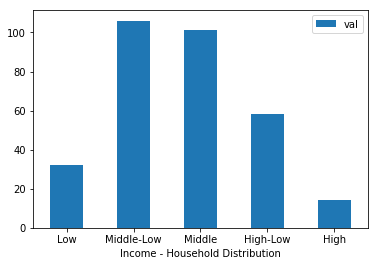

In [145]:
cluster0 = len([i for i in data_zip["Cluster Labels"] if i == 0])
cluster1 = len([i for i in data_zip["Cluster Labels"] if i == 1])
cluster2 = len([i for i in data_zip["Cluster Labels"] if i == 2])
cluster3 = len([i for i in data_zip["Cluster Labels"] if i == 3])
cluster4 = len([i for i in data_zip["Cluster Labels"] if i == 4])

df = pd.DataFrame({'Income - Household Distribution':['Low', 'Middle-Low', 'Middle', 'High-Low', 'High'], 'val':[cluster0, cluster1, cluster2, cluster3, cluster4]})
ax = df.plot.bar(x='Income - Household Distribution', y='val', rot=0)

## GeoJson
I used the python folium library to visualize the geographic details of Los Angeles and each city's estimated median income.
I used latitude and longitude values to get the map as below. 

The city boundaries are shown by zip code on the map, and the different colors show the clusters of estimated median income. Red is lower-income areas, and Blue is higher-income areas.

In [146]:
with open('Zip_Codes__LA_County_.geojson') as LA:
    gjdata = json.load(LA)
geo_data = gjdata['features']

#x = gjdata['features'][0]['properties']['ZIP']

In [147]:
MAP = folium.Map(location=[34.0522, -118.2437],tiles='cartodbpositron',zoom_start=10) 

i = 0

for each in geo_data:
    MAP.choropleth(
        geo_data=geo_data[i],
        name='choropleth',
        data=data_zip,
        columns=['ZIP', 'Cluster Labels'],
        key_on='properties.ZIP',
        fill_color='RdYlBu',
        fill_opacity=0.7,
        line_opacity=0.2)
    i = i + 1
    for key in MAP._children:
        if key.startswith('color_map'):
            del(MAP._children[key])

MAP

__As I expected, those beach cities are blue, which means high-income areas as well as surrounding suburb cities.__  
__Please note that some of the zip code does not have estimated household income data resulted in being shown with red.__

## Foursquare 
I used the Foursquare API to explore the preschools in Los Angeles. It limits the response of 100 venues for my API call, which may not be sufficient to support my hypothesis accurately, but I believe it still gives us a specific perspective and fact. 

In [148]:
CLIENT_ID = 'D0AGU1UH3RETNJF5RE3E5P5TAKJN2FIWM5BNUPYDJ2VUJAKQ' # your Foursquare ID
CLIENT_SECRET = 'TJC11CVWBBPGGKK441R04TFEA1ULFO1Y5H1T3ONPNKYXECIR' # your Foursquare Secret
VERSION = '20180604'

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)


address = 'Los Angeles, CA'
geolocator = Nominatim(user_agent="foursquare_agent")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude

print(latitude, longitude)

Your credentails:
CLIENT_ID: D0AGU1UH3RETNJF5RE3E5P5TAKJN2FIWM5BNUPYDJ2VUJAKQ
CLIENT_SECRET:TJC11CVWBBPGGKK441R04TFEA1ULFO1Y5H1T3ONPNKYXECIR
34.0536909 -118.2427666


In [149]:
search_query = 'Preschool'
radius = 100000
LIMIT = 10000
categoryId = "52e81612bcbc57f1066b7a45"
url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}&categoryId={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, search_query, radius, LIMIT, categoryId)
url

'https://api.foursquare.com/v2/venues/explore?client_id=D0AGU1UH3RETNJF5RE3E5P5TAKJN2FIWM5BNUPYDJ2VUJAKQ&client_secret=TJC11CVWBBPGGKK441R04TFEA1ULFO1Y5H1T3ONPNKYXECIR&ll=34.0536909,-118.2427666&v=20180604&query=Preschool&radius=100000&limit=10000&categoryId=52e81612bcbc57f1066b7a45'

In [150]:
results = requests.get(url).json()
venues = results['response']['groups'][0]['items']

def create_dataframe(keyword):
    i=0
    for venues[i] in venues:
        lst.append(venues[i]['venue'][keyword])
        i+=1
        
def create_dataframe2(list_n, keyword):
    i=0
    for venues[i] in venues:
        list_n.append(venues[i]['venue']['location'][keyword])
        i+=1

In [151]:
lst=[]
create_dataframe("name")

lst2=[]
create_dataframe2(lst2, 'lat')

lst3=[]
create_dataframe2(lst3, 'lng')

lst4=[]
create_dataframe2(lst4, 'city')
    
#lst5=[]
#create_dataframe2('postalCode')

df_venues = DataFrame(columns=['Venue Name', 'Latitude','Longitude', 'City'])
df_venues = pd.DataFrame({'Venue Name':lst, 'Latitude':lst2, 'Longitude':lst3, 'City':lst4})

Here is a head of the list Venues name, category, latitude and longitude informations from Forsquare API.

In [152]:
df_venues = df_venues[(df_venues["City"] != 'Anaheim') & (df_venues["City"] != 'Fullerton') & (df_venues["City"] != 'Buena Park') & (df_venues["City"] != 'Los Alamitos') & (df_venues["City"] !=  'Cypress') & (df_venues["City"] !=  'La Palma') & (df_venues["City"] !=  'Garden Grove')]
df_venues = df_venues.reset_index()
df_venues

,index,Venue Name,Latitude,Longitude,City
0,0,Acting with Alisha Los Angles top youth acting...,34.053122,-118.244798,Los Angeles
1,1,Alcazar Child Development Center at USC,34.063663,-118.201448,Los Angeles
2,2,Lily Preschool,34.062897,-118.302483,Los Angeles
3,3,Sae Ssak Preschool,34.074281,-118.307548,Los Angeles
4,4,Ethel Education,34.079216,-118.310126,Los Angeles
5,5,First United Methodist Preschool,34.188041,-118.312322,Burbank
6,6,Lake Avenue Preschool,34.162839,-118.132846,Pasadena
7,7,Creative Angels Preschool/Kindergarten,34.102546,-118.299750,Los Angeles
8,8,Creative Learning Academy,34.010646,-118.309754,Los Angeles
9,9,Paper Pinecone,34.061932,-118.345413,Los Angeles


# Result
__Now, let's plot the preschool location with a pin on the map to analyze if it has relationship with each city's estimated median income.__

In [153]:
for lat, lng, vname in zip(df_venues['Latitude'], df_venues['Longitude'], df_venues['Venue Name']):
    label = folium.Popup(vname, parse_html=True)
    folium.Marker(
    [lat,lng],
    popup = label,
    ).add_to(MAP)

MAP

__As expected, it turns out that there are fewer childcare facilities in the city of Los Angeles and low-income areas, primarily downtown.   
Conversely, there are more childcare facilities in the higher-income seaside and suburban areas.__

# Education Opportunity Ration per children
I want to explore another possibility of children's educational opportunities varies based on the area that they live in. Suppose the income of the city and the number of school locations are in a positive correlation. (Positive correlation is a relationship between two variables in which both variables move in tandem—that is, in the same direction.) 

I imported the population data from the city of Los Angeles. There is no exact number of 3 to 5 years children population data available anywhere. So, I used the `Age 0 - 15` population and divided it by 5, assuming the population demographic is equally spread out. 

In [154]:
with open('Estimated_Population_Age.csv') as popu:
    population = pd.read_csv(popu)
    
population.tail()

,Census_Tract,FIPS,CITYNAME,Service_Area,Age_0_15,Age_16_18,Age_19_20,Age_21_25,Age_26_59,Age_60_64,...,Male,Female,White,African_American,Native_ American,Asian,Pacific Islander,Other,Multi-Race,Latino
2797,980028,44000,Los Angeles city - Westchester,5,0,0,0,0,3,0,...,1,3,0,2,0,0,0,0,0,2
2798,980030,22412,El Segundo city,8,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2799,980031,44000,Los Angeles city - San Pedro,8,8,8,8,52,918,77,...,1134,87,490,222,23,52,20,1,36,377
2800,980033,43000,Long Beach city,8,2,1,1,2,33,6,...,44,9,29,4,0,8,1,0,3,8
2801,990300,43000,Long Beach city,8,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [155]:
d = df_venues['City'].value_counts().to_dict()
df_num = pd.DataFrame(list(d.items()), columns=['City', 'Number'])

df_num['Estimated 2-5YRs Population'] = 0

,City,Number,Estimated 2-5YRs Population
0,Los Angeles,25,0
1,Santa Monica,5,0
2,Glendale,4,0
3,Burbank,4,0
4,Venice,3,0
5,Pasadena,3,0
6,Monrovia,2,0
7,Altadena,2,0
8,Arcadia,2,0
9,Temple City,2,0


In [193]:
i=0
for city, EP in zip(df_num['City'], df_num['Estimated 2-5YRs Population']):
    EP = ((sum([pop2 for pop1, pop2 in zip(population['CITYNAME'], population['Age_0_15']) if pop1.startswith(city)]))/5)
    df_num.at[i, 'Estimated 2-5YRs Population'] = EP
    i+=1

df_num['Ratio'] = df_num['Number']/df_num['Estimated 2-5YRs Population']
df_final = df_num.sort_values(by=["Ratio"],ascending=False)

drop_index2 = df_final.index[df_final["Estimated 2-5YRs Population"] == 0]
df_final = df_final.drop(drop_index2)

df_final

,City,Number,Estimated 2-5YRs Population,Ratio
29,Industry,1,9,0.111111
36,Rolling Hills Estates,1,225,0.004444
14,West Hollywood,1,425,0.002353
1,Santa Monica,5,2377,0.002103
9,Temple City,2,1115,0.001794
38,Santa Fe Springs,1,726,0.001377
6,Monrovia,2,1476,0.001355
39,Walnut,1,770,0.001299
42,Duarte,1,800,0.001250
3,Burbank,4,3352,0.001193


In [194]:
d= pd.read_html('https://en.wikipedia.org/wiki/List_of_California_locations_by_income', match = 'Acampo')

# The dataframe will consist of three columns: PostalCode, Borough, and Neighborhood
df1 = d[0]

df2 = df1.drop(['Population[1]', 'Populationdensity[1][2][note 1]', 'Per capita income[3]', 'Median household income[6]'], 1)
df2 = df2.rename(columns={'County/ies[note 2]': "county", "Place": "City", "Median family income[5]": "median family income"})

drop_index1 = df2.index[df2["median family income"] == '[7]']
df3 = df2.drop(drop_index1)

df4 = df3[df3['county'].isin(['Los Angeles'])].copy()
df4["median family income"] = df4["median family income"].map(lambda x: x.lstrip('$'))
df4["median family income"] = df4["median family income"].map(lambda x: float(x.replace(',', '')))
df4 = df4.drop_duplicates(subset=['City']).reset_index()
df4 = df4.drop(['index', 'county'], 1)
df4

,City,median family income
0,Acton,99448.0
1,Agoura Hills,118673.0
2,Agua Dulce,102989.0
3,Alhambra,57056.0
4,Alondra Park,57944.0
5,Altadena,94886.0
6,Arcadia,93635.0
7,Artesia,62485.0
8,Avalon,56765.0
9,Avocado Heights,74382.0


In [199]:
df_plot = pd.merge(df_final, df4, how="inner", on = "City")
df_plot = df_plot.drop(index=0)
df_plot = df_plot.drop(['City', 'Number', 'Estimated 2-5YRs Population'], 1)
df_plot = df_plot.sort_values(by=['median family income'])
df_plot

,Ratio,median family income
25,0.000191,40727.0
26,0.000186,45877.0
24,0.000197,46449.0
15,0.000589,53023.0
27,0.000157,54171.0
18,0.000551,55150.0
28,0.000050,59710.0
14,0.000669,61806.0
5,0.001377,63333.0
2,0.002353,70438.0


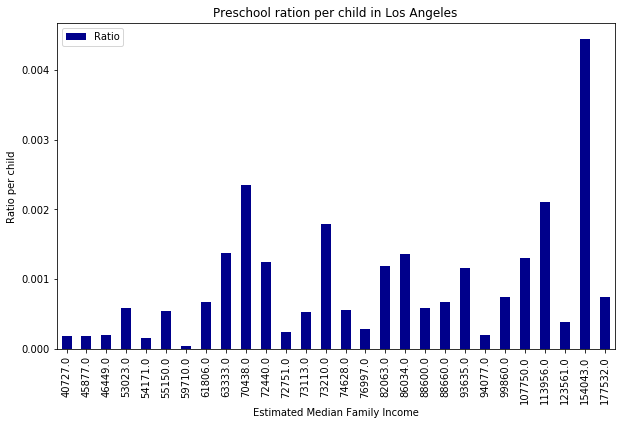

In [200]:
df_plot.plot(kind='bar', x='median family income', y='Ratio', figsize=(10, 6), color='darkblue')
plt.title('Preschool ration per child in Los Angeles')
plt.xlabel('Estimated Median Family Income')
plt.ylabel('Ratio per child')
plt.show()

As a result, the results suggest that early childhood education facilities are relatively more prevalent in middle-class and upper-class areas.

# Discussion

Everyone knows for a fact that while Los Angeles is a large city, people are segregated by race and wealth. This attempt used only minimal indices and data, so the causes and precise categorization of this problem are remained open to study. However, we have shown that access to education depends on the area where one lives and wealth.

Of course, more complex explanations may be required in practice, as historical context and political factors also need to be taken into account. Besides, some clustering and classification studies may try very different approaches. It is essential to note that not all classification methods will produce the results as this study.

I used the Kmeans algorithm as part of this clustering study. As an extension of this study, it may be possible to use linear regressions to predict simple future predictions, taking into account population growth rates, economic indices, and inflation, which is currently being led by the US government.

This study's results could influence future development plans for the city and the decision making process for education plans.

# Conclusion

The gap between the rich and the poor has become a hot topic that symbolizes division and inequality in the United States today, and it is getting people's attention.

I do not mean to criticize American-style capitalism, but I believe that our children's education should be ethical and equal. Humanity and morality must not be sacrificed to market forces.

I hope this study to be used by city officials and local legislators to bring about some positive results.